# 📜 Gate 3: The Hall of Convergence  

You now stand before the **Third Gate**, known as the **Hall of Convergence**.  
Here, the fractured shards of vision must be brought back together into a single whole.  
The walls of this hall shimmer with fragments of broken images, floating and misaligned — waiting for your hand to restore them.  

---

### 👁️ The Archivist’s Words  

> You have already passed through the Gates of Inversion and Recognition.  
> You have learned to return fragments to their true form and to reveal hidden correspondences through the Algorithms of Sight.  
>  
> But now, Visioneer, comes the trial of **Convergence**.

---

### 🔑 Your Task  

You are given:  

- **Region 1 (ref_plane_img)** — the unbroken fragment, the sacred base plane.  
- **Regions 2, 3, and 4 (warped_region_1.png,warped_region_2.png,warped_region_3.png)** — shards that have been restored from distortion, but remain displaced.  
- Their **Homographies** — the secret maps of alignment.  

Your mission:  

1. **Warp** each shard into the plane of Region 1 using the given homographies.  
2. **Stitch** them into a single canvas, reconstructing the hidden whole.  
3. Ensure that Region 1 remains the base foundation, unaltered and true.  

---

### ⚠️ The Archivist’s Warning  

> Beware, Visioneer.  
> Many attempt to cheat, letting false algorithms do the work.  
> But this Gate tests your mastery, not your shortcuts.  
>  
> The careless will summon only chaos — broken seams, misaligned truths, or blank voids.  
> Only by true effort will you restore the Vision.

---

### 🎯 Goal  

Pass through the **Hall of Convergence**, and you will emerge not as an apprentice but as a **Weaver of Worlds** — one who can take the scattered and make it whole.  



Displaying input images for I1: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


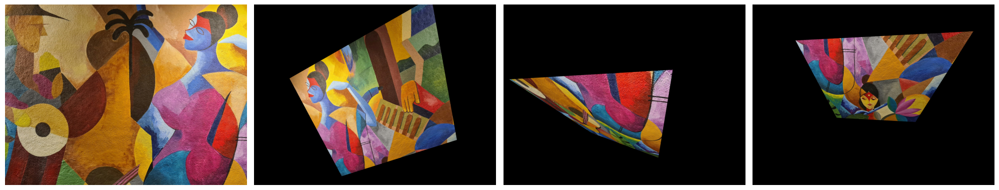


Displaying input images for I2: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


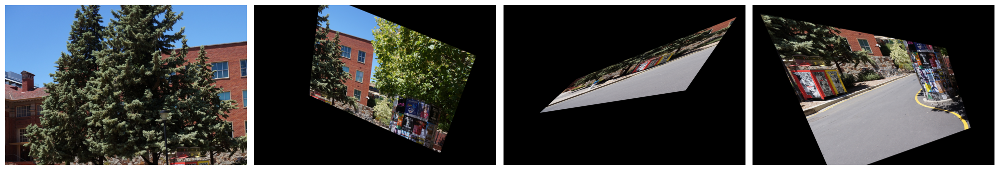


Displaying input images for I3: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


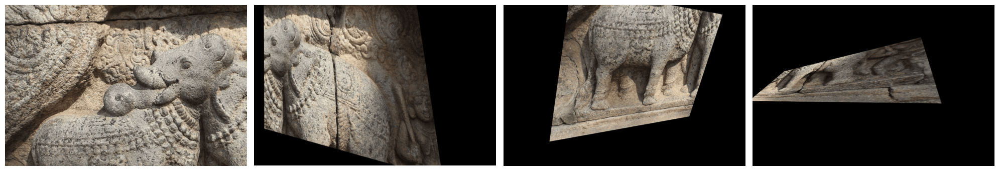


Displaying input images for I4: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


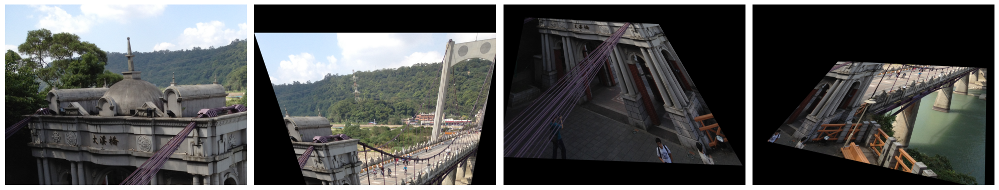


Displaying input images for I5: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


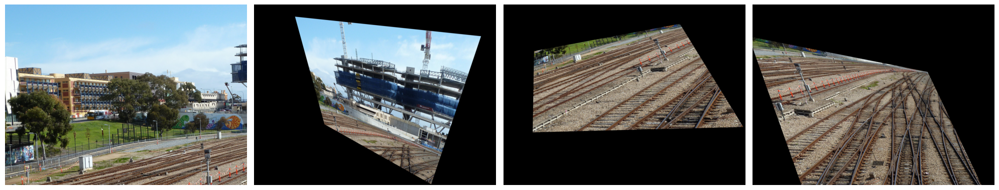

In [ ]:
## Importing recipes
%matplotlib inline

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab import drive
# Mounting google drive
drive.mount('/content/drive')

def display_images_in_row(images, cmap='gray'):
    fig, axs = plt.subplots(1, len(images), figsize=(5 * len(images), 5))
    if len(images) == 1:
        axs = [axs]
    for ax, img in zip(axs, images):
        ax.imshow(img, cmap=cmap)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

base_dir = "/content/drive/MyDrive/ES666CV/images/C"  # Base directory containing I1, I2, ..., I5
all_images = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)

    # List to store restored images for this dataset
    images = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)

        # Inverse warp
        images.append(warped_img)

    # Add restored images for this dataset to the main list
    all_images.append(images)


for idx,imgs in enumerate(all_images):
  print(f"\nDisplaying input images for I{idx+1}: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3")
  display_images_in_row(imgs, cmap=None)


# Task 1: Implement Inverse Warping from scratch (4 marks)
**Instructions:**

* Implement `warpPerspective_from_scratch(img, H, output_shape)` to
warp the input image img to a new plane. **The homography H maps coordinates in the source image to the target plane**, and output_shape defines the size (height, width) of the output.

* Implement `restore_images_in_reference_plane(img, H, output_shape)` to map a warped image img back to the reference plane using the inverse of H. **Here, H is the homography that originally mapped the reference plane to the warped image.**


In [2]:
def warpPerspective_from_scratch(img, H, output_shape):
    """
    Inverse warp an image using a given homography matrix H.

    Parameters:
    img : np.array
        Input image to be warped.
    H : np.array
        Homography matrix mapping source -> target plane.
    output_shape : tuple
        (height, width) of the target image.

    Returns:
    restored : np.array
        The warped image of shape output_shape.
    """
    h, w = output_shape
    restored = np.zeros((h, w, img.shape[2]), dtype=img.dtype)

    ## TODO: Implement pixel-by-pixel inverse mapping using H
    ## Hint: For each pixel in source image, compute its destination in the output plane.
    channels = img.shape[2] if img.ndim==3 else 1
    H_inv = np.linalg.inv(H)

    for y_t in range(h):
        for x_t in range(w):
            target_pixel = np.array([x_t, y_t, 1.0])
            source_pixel = H_inv @ target_pixel
            source_pixel /= source_pixel[2]     # normalize to get inhomogeneous coordinates
            x_s, y_s = source_pixel[0], source_pixel[1]

            # Check if source pixel is within image bounds
            if 0 <= x_s < img.shape[1] and 0 <= y_s < img.shape[0]:
                x0 = int(np.floor(x_s))
                x1 = min(x0 + 1, img.shape[1] - 1)
                y0 = int(np.floor(y_s))
                y1 = min(y0 + 1, img.shape[0] - 1)
                dx = x_s - x0
                dy = y_s - y0

                if channels > 1:
                    for c in range(channels):
                        # Bilinear interpolation
                        restored[y_t, x_t, c] = (
                            (1 - dx) * (1 - dy) * img[y0, x0, c] +
                            dx * (1 - dy) * img[y0, x1, c] +
                            (1 - dx) * dy * img[y1, x0, c] +
                            dx * dy * img[y1, x1, c]
                        )
                else:
                    # Grayscale image
                    restored[y_t, x_t] = (
                        (1 - dx) * (1 - dy) * img[y0, x0] +
                        dx * (1 - dy) * img[y0, x1] +
                        (1 - dx) * dy * img[y1, x0] +
                        dx * dy * img[y1, x1]
                    )
    return restored


def restore_images_in_reference_plane(img, H, output_shape):
    """
    Restore a warped image back to the reference plane using inverse homography.

    Parameters:
    img : np.array
        Warped image to be restored.
    H : np.array
        Homography matrix mapping reference -> warped plane.
    output_shape : tuple
        (height, width) of the reference plane.

    Returns:
    warped : np.array
        Restored image in the reference plane.
    """
    h_out, w_out = output_shape

    ## TODO: Compute H inverse: H_inv
    ## TODO: For each pixel in the output (reference) plane, compute the corresponding
    ## pixel location in the warped image using H_inv.
    H_new = np.linalg.inv(H)
    warped = warpPerspective_from_scratch(img, H_new, (h_out, w_out))

    return warped


Processing dataset: I1

Processing dataset: I2

Processing dataset: I3

Processing dataset: I4

Processing dataset: I5

Displaying restored images for I1:


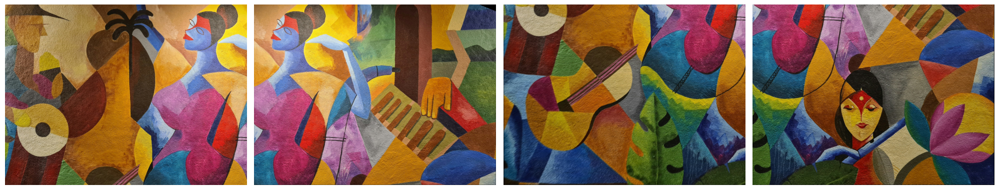


Displaying restored images for I2:


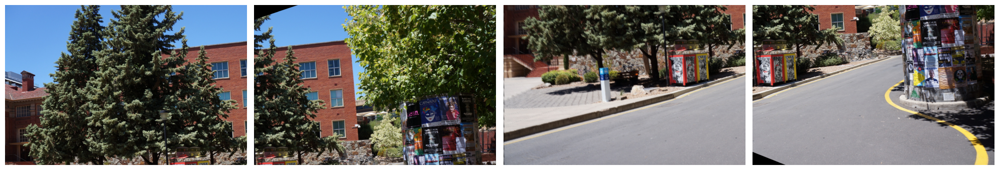


Displaying restored images for I3:


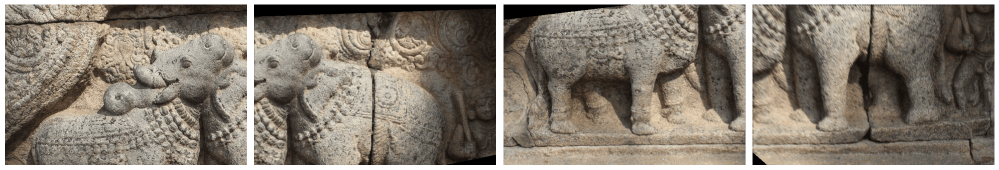


Displaying restored images for I4:


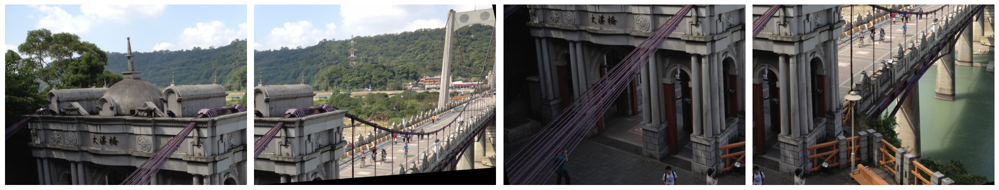


Displaying restored images for I5:


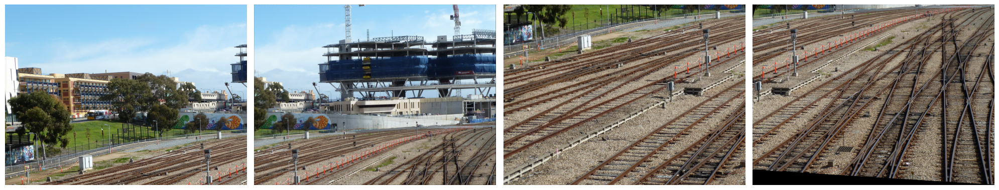

In [3]:

restored_all = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    print(f"\nProcessing dataset: {dataset}")

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)
    h_out, w_out = ref_img.shape[:2]

    # Directory containing homography matrices
    homography_dir = os.path.join(dataset_path, "homographies")

    # List to store restored images for this dataset
    restored_dataset = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")
        H_path = os.path.join(homography_dir, f"H_region_{i}.txt")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)
        H = np.loadtxt(H_path)

        # Inverse warp
        restored_img = restore_images_in_reference_plane(warped_img, H, (h_out, w_out))
        restored_dataset.append(restored_img)

        # save restored image
        # output_dir = os.path.join(dataset_path, "restored")
        # os.makedirs(output_dir, exist_ok=True)
        # save_path = os.path.join(output_dir, f"restored_warped_region_{i}.png")
        # cv2.imwrite(save_path, restored_img)
        # print(f"Saved: {save_path}")

    # Add restored images for this dataset to the main list
    restored_all.append(restored_dataset)


for idx,imgs in enumerate(restored_all):
  print(f"\nDisplaying restored images for I{idx+1}:")
  display_images_in_row(imgs, cmap=None)


📖 **Theory Question:** Explain the difference between forward warping and inverse warping. Why is inverse warping generally preferred?

**Answer:**

Forward warping maps each pixel from the source image to its destination in the target plane using a homography $H$:

$$[x', y', 1]^T = H[x, y, 1]^T$$

The problem is that multiple source pixels can map to the same target pixel or leave holes (empty pixels) if the mapping is not one-to-one. Inverse warping, on the other hand, iterates over each pixel in the target image and computes the corresponding source pixel using $H^{-1}$. This guarantees every target pixel gets a value, avoiding holes. 

$$[x, y, 1]^T = H^{-1}[x', y', 1]^T$$

Due to this reason, inverse warping is generally preferred in practice over forward warping as it produces complete images without gaps.

# Task 2: Keypoint Detection and Homography Estimation (4 marks)
**Instructions:**

* Detect keypoints and compute descriptors for each image using SIFT. Then, match keypoints between each restored region and the reference image. **You may use OpenCV functions for both detecting SIFT keypoints and matching descriptors.**

* Implement homography estimation using RANSAC from scratch. Do not use OpenCV’s findHomography for this step. Compute the homography matrix that aligns each region to the reference plane.

In [4]:
def detect_keypoints_sift(img):
    """
    Detect keypoints and compute descriptors using SIFT.

    Parameters:
    img : np.array
        Input image in which keypoints are to be detected.

    Returns:
    keypoints : list
        Detected keypoints in the image.
    descriptors : np.array
        Feature descriptors corresponding to the keypoints.
    """
    ## TODO: Convert image to grayscale
    ## TODO: Detect SIFT keypoints
    ## TODO: Compute descriptors for the keypoints

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) if img.ndim == 3 else img.copy()

    # Create SIFT detector
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    return keypoints, descriptors

In [5]:
def match_keypoints(des1, des2, ratio_thresh=0.75):
    """
    Match descriptors between two images using nearest neighbor and ratio test.

    Parameters:
    des1 : np.array
        Descriptors from the first image.
    des2 : np.array
        Descriptors from the second image.
    ratio_thresh : float
        Ratio threshold for filtering ambiguous matches.

    Returns:
    good_matches : list
        List of filtered good matches passing the ratio test.
    """
    ## TODO: Match descriptors using nearest neighbor (Using OpenCV)
    ## TODO: Apply ratio test to filter matches

    # BFMatcher with L2 since SIFT descriptors are float
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    # find the two nearest neighbours for each descriptor in des1
    knn_matches = bf.knnMatch(des1, des2, k=2)

    # Apply ratio test
    good_matches = []
    for m, n in knn_matches:
        if m.distance < ratio_thresh * n.distance:
            good_matches.append(m)

    return good_matches

In [6]:
def compute_homography_ransac(kp1, kp2, matches, iterations=1000, threshold=5, use_best_inliers=False):
    """
    Compute homography using matched keypoints and RANSAC.

    Parameters:
    kp1 : list
        Keypoints from the first image.
    kp2 : list
        Keypoints from the second image.
    matches : list
        Matches between keypoints of the two images.
    iterations : int
        Number of RANSAC iterations.
    threshold : float
        Distance threshold to classify inliers.

    Returns:
    H : np.array
        Estimated homography matrix mapping kp1 -> kp2.
    """
    ## TODO: Implement RANSAC to find the best homography
    ## TODO: Convert keypoints to coordinates
    ## TODO: Iteratively estimate H and count inliers

    n_matches = len(matches)
    if n_matches < 4:
        raise ValueError("Need atleast 4 matches to compute homography.")
    
    # Convert keypoints matches to point arrays
    pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])    # shape (N,2)
    pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])    # shape (N,2)

    best_H = None
    best_inliers = []
    max_inlier_count = 0

    for _ in range(iterations):
        # Randomly select 4 matches
        idxs = np.random.choice(n_matches, 4, replace=False)
        src_pts = pts1[idxs]
        dst_pts = pts2[idxs]

        # Build homography from source to destination
        # Construct matrix A for DLT
        A = []
        for (x,y), (u,v) in zip(src_pts, dst_pts):
            A.append([-x, -y, -1, 0, 0, 0, x*u, y*u, u])
            A.append([0, 0, 0, -x, -y, -1, x*v, y*v, v])
        A = np.array(A, dtype=np.float64)

        # Solve Ah=0 using SVD
        U, S, Vt = np.linalg.svd(A)
        H_candidate = Vt[-1].reshape(3,3)
        H_candidate /= H_candidate[2,2]  # Normalize

        # Compute inliers
        # Transform all src_pts by H_candidate and measure distance to dst_pts
        src_hom = np.hstack([pts1, np.ones((n_matches,1))])  # shape (N,3)
        projected_pts = (H_candidate @ src_hom.T).T                    # shape (N,3)
        projected_pts /= projected_pts[:,2][:,np.newaxis]    # normalize

        diffs = pts2 - projected_pts[:,:2]
        errors = np.linalg.norm(diffs, axis=1)

        inliers_idxs = np.where(errors < threshold)[0]
        inlier_count = len(inliers_idxs)

        if inlier_count > max_inlier_count:
            max_inlier_count = inlier_count
            best_inliers = inliers_idxs
            best_H = H_candidate
        
        if best_inliers is None:
            raise ValueError("RANSAC failed to find a valid homography.")

    if use_best_inliers:
        A = []
        for idx in best_inliers:
            x, y = pts1[idx]
            u, v = pts2[idx]
            A.append([-x, -y, -1, 0, 0, 0, x*u, y*u, u])
            A.append([0, 0, 0, -x, -y, -1, x*v, y*v, v])
        A = np.array(A, dtype=np.float64)
        U, S, Vt = np.linalg.svd(A)
        best_H = Vt[-1].reshape(3,3)
        best_H /= best_H[2,2]  # Normalize 

    H = best_H
    return H


Processing dataset 1
Dataset 1, Region 2 Homography:
 [[ 1.00763289e+00 -6.01864223e-03  1.61335412e+03]
 [ 3.36236684e-03  9.96526865e-01  1.17419621e+00]
 [ 3.36269145e-06 -2.73227835e-06  1.00000000e+00]]


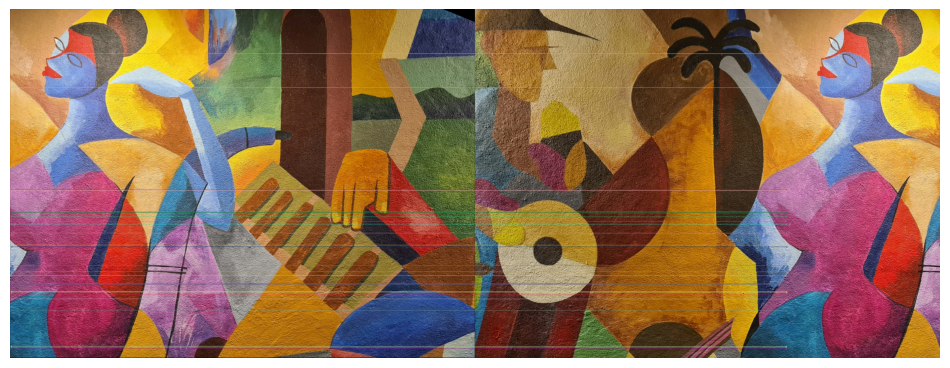

Dataset 1, Region 3 Homography:
 [[ 1.00109736e+00 -1.20827537e-02  1.86449801e+00]
 [ 1.22858709e-03  9.91234248e-01  1.20984075e+03]
 [ 1.17517254e-06 -6.36215254e-06  1.00000000e+00]]


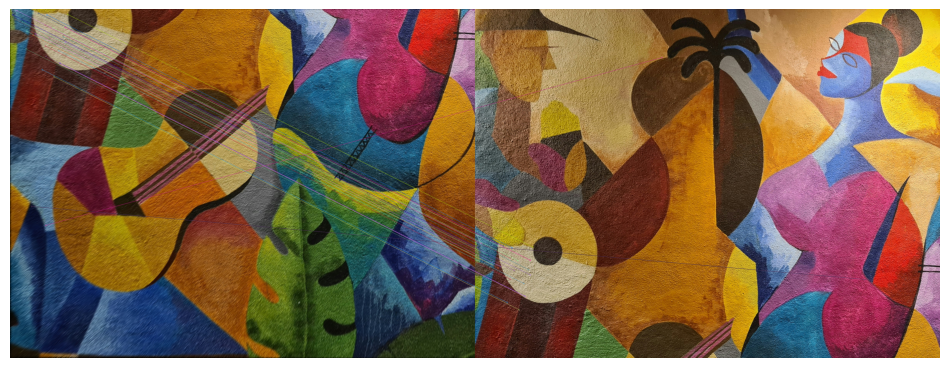

Dataset 1, Region 4 Homography:
 [[ 9.83648142e-01  2.52342878e-03  1.61444123e+03]
 [-8.89401813e-03  9.98097989e-01  1.21058019e+03]
 [-6.64141297e-06  1.28693390e-06  1.00000000e+00]]


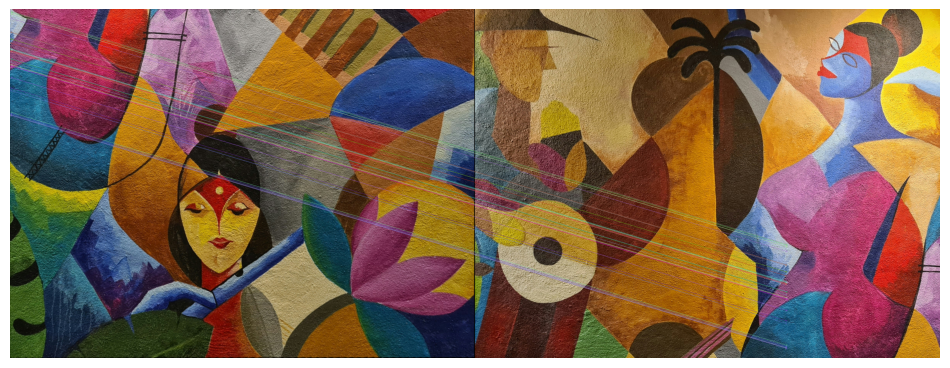


Processing dataset 2
Dataset 2, Region 2 Homography:
 [[ 9.69934127e-01 -1.27521270e-02  8.01627382e+02]
 [-9.82572434e-03  9.83629922e-01  4.68873060e+00]
 [-2.01594795e-05 -1.31189297e-05  1.00000000e+00]]


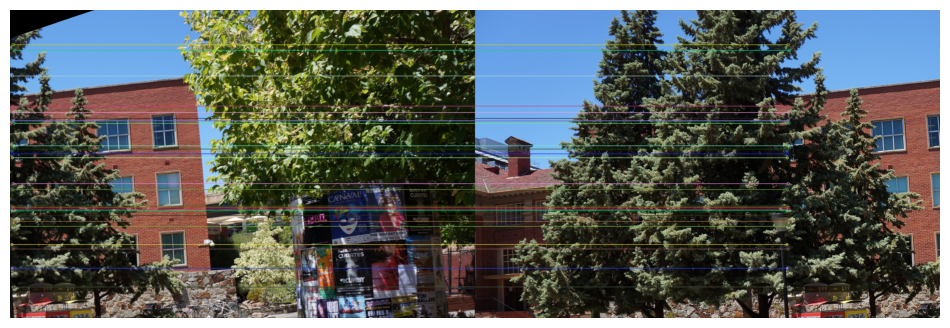

Dataset 2, Region 3 Homography:
 [[ 9.92867246e-01 -2.39468657e-03  2.91309542e+00]
 [-1.97871377e-03  9.92418396e-01  5.32381769e+02]
 [-4.60626439e-06 -1.35805749e-07  1.00000000e+00]]


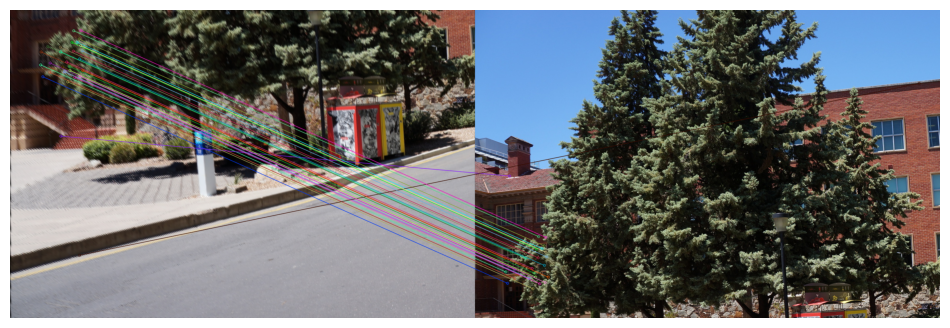

Dataset 2, Region 4 Homography:
 [[ 1.03571945e+00 -2.65265892e-02  8.00110694e+02]
 [ 2.49179683e-02  9.81786928e-01  5.31996804e+02]
 [ 3.86183294e-05 -2.82146333e-05  1.00000000e+00]]


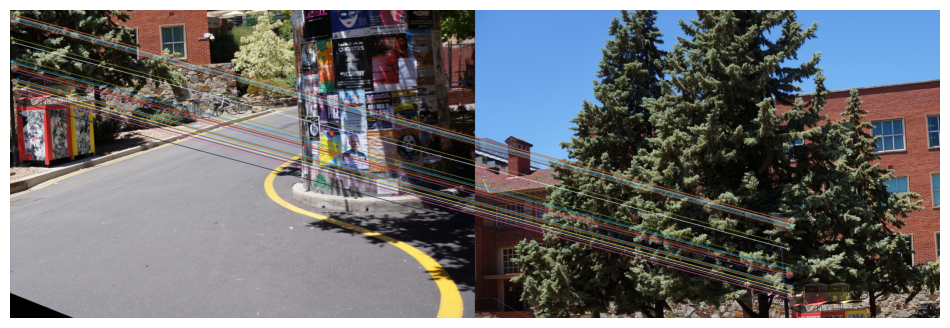


Processing dataset 3
Dataset 3, Region 2 Homography:
 [[ 1.02928503e+00  1.12154753e-02  4.09707569e+02]
 [ 7.09559956e-03  1.01648246e+00 -2.28934827e+00]
 [ 3.91301510e-05  2.64214163e-05  1.00000000e+00]]


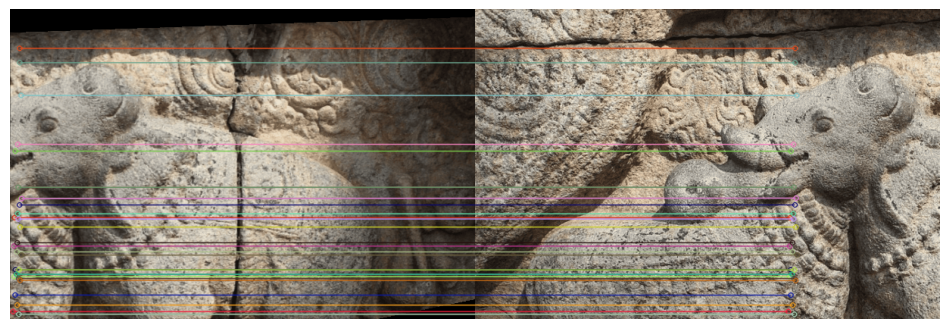

Dataset 3, Region 3 Homography:
 [[ 1.00076622e+00 -3.02074299e-02  6.49854001e-01]
 [ 6.28569383e-03  9.48139069e-01  2.73122304e+02]
 [ 1.65858110e-05 -1.38408953e-04  1.00000000e+00]]


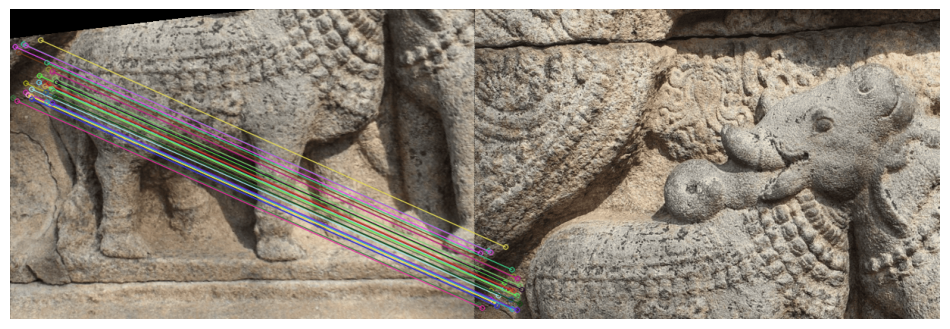

Dataset 3, Region 4 Homography:
 [[ 6.39279237e-01  2.83910394e-01  4.06846120e+02]
 [-2.08277049e-01  1.07921030e+00  2.74441298e+02]
 [-6.28270455e-04  3.07111191e-04  1.00000000e+00]]


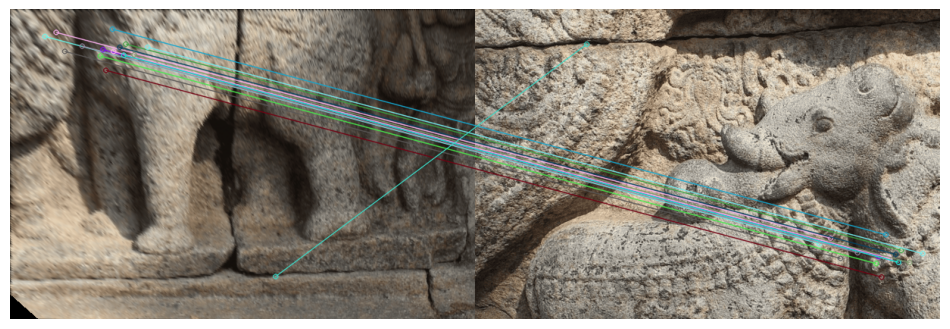


Processing dataset 4
Dataset 4, Region 2 Homography:
 [[ 9.94095083e-01 -5.18600555e-03  1.30597442e+03]
 [-4.53308884e-03  9.92075433e-01  4.85502863e+00]
 [-2.42554903e-06 -3.78514972e-06  1.00000000e+00]]


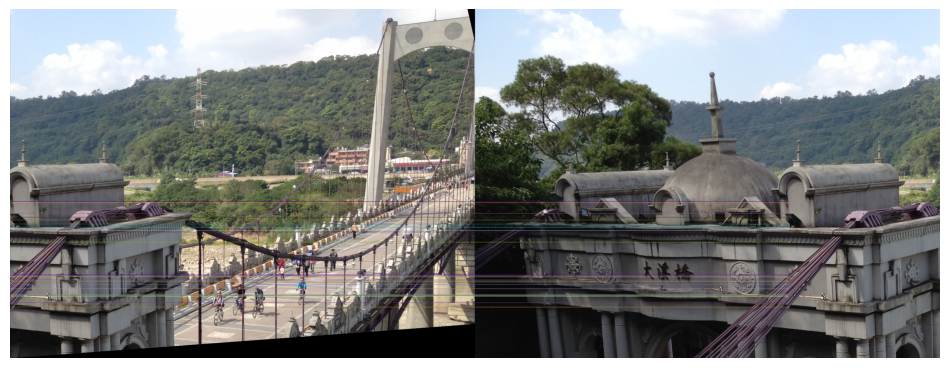

Dataset 4, Region 3 Homography:
 [[ 9.94047511e-01 -2.52433638e-03  2.59359183e+00]
 [-4.23511251e-03  9.99670659e-01  9.80461379e+02]
 [-4.11637396e-06  4.20948510e-06  1.00000000e+00]]


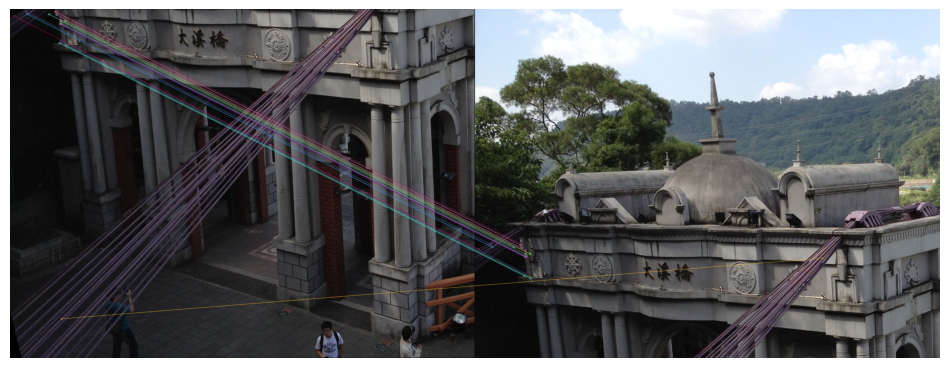

Dataset 4, Region 4 Homography:
 [[ 9.82769801e-01 -3.33775610e-02  1.30685853e+03]
 [-1.08659402e-02  9.67039109e-01  9.81055855e+02]
 [-7.59011008e-06 -2.26692720e-05  1.00000000e+00]]


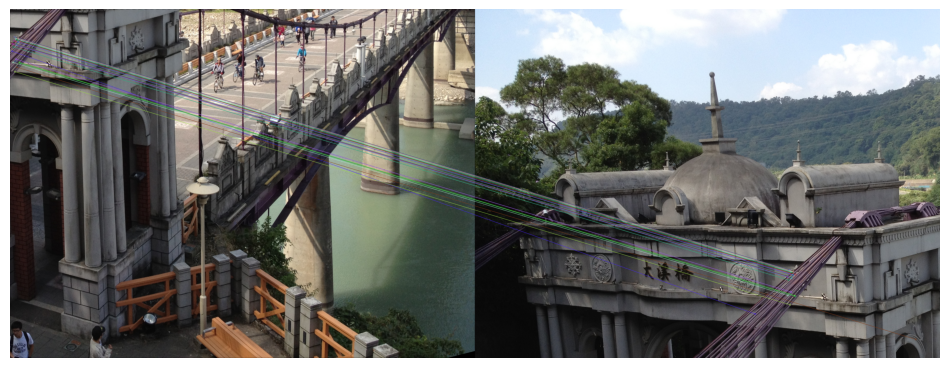


Processing dataset 5
Dataset 5, Region 2 Homography:
 [[ 1.00651541e+00  3.01376109e-03  7.99301968e+02]
 [ 1.99859275e-03  1.00111691e+00 -1.15006774e-01]
 [ 5.15588369e-06  1.21629062e-06  1.00000000e+00]]


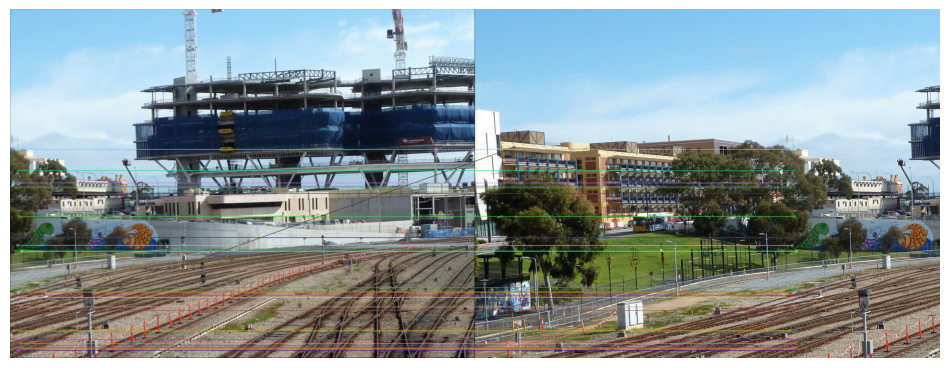

Dataset 5, Region 3 Homography:
 [[ 9.91051849e-01 -8.90778649e-03  3.55746408e+00]
 [-3.57117267e-03  9.88269541e-01  6.00250441e+02]
 [-5.00431231e-06 -1.03204466e-05  1.00000000e+00]]


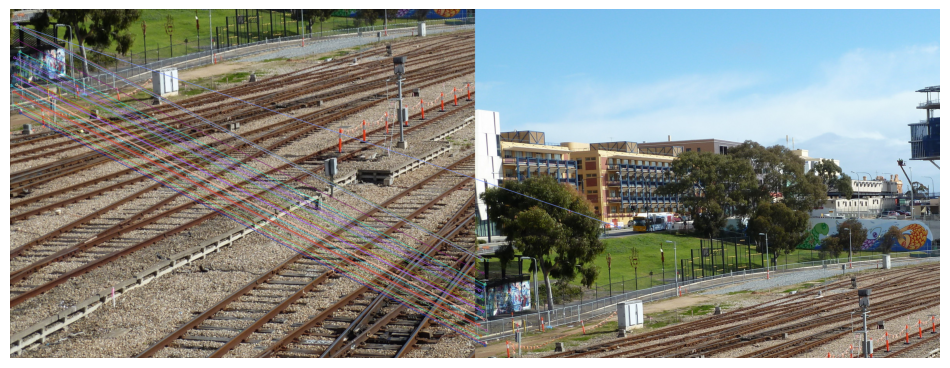

Dataset 5, Region 4 Homography:
 [[ 8.88770790e-01 -2.45292183e-02  8.01272453e+02]
 [-7.38556450e-02  9.47066691e-01  6.05768654e+02]
 [-9.47739627e-05 -2.68335201e-05  1.00000000e+00]]


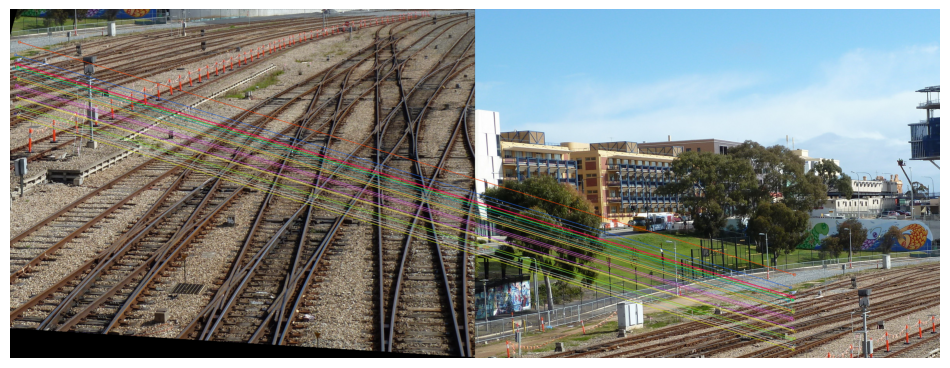

In [7]:
homographies_all = []  # nested list: [dataset][region_index] -> H

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\nProcessing dataset {dataset_idx+1}")
    homographies_dataset = []

    # Use the reference image as base (assume region_1 is at index 0)
    ref_img = dataset_images[0]
    kp_ref, des_ref = detect_keypoints_sift(ref_img)

    # Compute homography for each of the other restored regions
    for region_idx in range(1, len(dataset_images)):
        img = dataset_images[region_idx]
        kp, des = detect_keypoints_sift(img)

        matches = match_keypoints(des, des_ref)


        H = compute_homography_ransac(kp, kp_ref, matches)
        homographies_dataset.append(H)

        print(f"Dataset {dataset_idx+1}, Region {region_idx+1} Homography:\n", H)

        # visualize matches
        img_matches = cv2.drawMatches(img, kp, ref_img, kp_ref, matches[:30], None, flags=2)
        plt.figure(figsize=(12,6))
        plt.imshow(img_matches)
        plt.axis('off')
        plt.show()

    homographies_all.append(homographies_dataset)

📖 **Theory Question:** What could happen if you compute a homography using all matched points without handling outliers? Give an example.

**Answer:**

If you compute a homography using all matched points, even bad matches (outliers) will influence the final result, which will give large residuals and produce a completely wrong mapping/transformation matrix $H$.

For example, suppose most matches are correct, but a few keypoints are matched incorrectly due to repetitive textures. These outliers can shift the computed homography so that straight lines bend or the region misaligns. Mathematically, a standard least-squares fit minimizes $\sum_i ||H \cdot \mathbf{x}_i - \mathbf{x}'_i||^2$. Outliers have large errors $||H \cdot \mathbf{x}_i - \mathbf{x}'_i||$, which dominate the sum and skew $H$, making the alignment unreliable. That's why RANSAC or robust estimation is essential.


# Task 3: Stitch the Images to Form the Original Image (2 Marks)

* Complete the function `stitch_with_known_homographies(base_img, other_imgs, homographies)` to stitch all regions into the original reference plane.
* **Use your implementation of `warpPerspective_from_scratch()` to warp each region into the base image plane.**
* **Ensure the base image (ref_plane_img.png) remains unaltered and all warped regions are aligned correctly using the homographies you have calculated in the preevious step.**
* Return the final stitched image with the same dimensions as the base image.

In [ ]:
def stitch_with_known_homographies(base_img, other_imgs, homographies):
    """
    Stitch multiple image regions into the plane of a base image using known homographies.

    Parameters:
    base_img : np.array
        Reference image (Region 1) that serves as the base plane.
    other_imgs : list of np.array
        Restored regions (e.g., Regions 2, 3, 4) to be stitched.
    homographies : list of np.array
        Homography matrices mapping each region to the base image plane.

    Returns:
    stitched_image : np.array
        The final stitched image containing all regions aligned to the base plane.
    """
    ## TODO: Determine the canvas size for stitching
    ## TODO: Place the base image in the canvas
    ## TODO: Translate homographies to canvas coordinates if needed
    ## TODO: Warp each region using your warpPerspective implementation
    ## TODO: Merge warped regions onto the canvas (e.g., simple overwrite or blending)

    h_base, w_base = base_img.shape[:2]

    # 1) Collect corners in base coordinates
    corners = []

    # base image corners (use w_base-1,h_base-1 to represent pixel corners)
    base_corners = np.array([
        [0, 0], 
        [w_base-1, 0],
        [w_base-1, h_base-1],
        [0, h_base-1]
    ], dtype=np.float64)
    corners.extend(base_corners)

    # other images: map their corners into base coordinates using provided homographies
    for img, H in zip(other_imgs, homographies):
        h_region, w_region = img.shape[:2]
        pts = np.array([
            [0, 0],
            [w_region-1, 0],
            [w_region-1, h_region-1],
            [0, h_region-1]
        ], dtype=np.float64)      # shape (4,2)
        pts_hom = np.hstack([pts, np.ones((4, 1))])              # shape (4,3)
        warped_pts_hom = (H @ pts_hom.T).T                    # shape (4,3)
        # convert to inhomogeneous coordinates
        warped_pts = warped_pts_hom[:, :2] / warped_pts_hom[:, [2]]         # normalize
        corners.extend(warped_pts)

    corners = np.array(corners, dtype=np.float64)       # shape (N,2)

    # 2) compute bounding box of all corners
    xmin, ymin = np.floor(np.min(corners, axis=0)).astype(int)
    xmax, ymax = np.ceil(np.max(corners, axis=0)).astype(int)
    width = int(xmax-xmin+1)
    height = int(ymax-ymin+1)

    # 3) compute translation matrix to shift everything into positive coordinates
    translation_matrix = np.array([
        [1.0, 0.0, -xmin],
        [0.0, 1.0, -ymin],
        [0.0, 0.0, 1.0]
    ], dtype=np.float64)

    print(f"[INFO] Canvas origin offset: ({xmin},{ymin}), size: {width}x{height}")

    # 4) warp base image into canvas using translation_matrix (base to canvas)
    stitched_image = warpPerspective_from_scratch(base_img, translation_matrix, (height, width))

    # 5) warp each additional region using H_translated = translation_matrix @ H
    for img, H in zip(other_imgs, homographies):
        H_translated = translation_matrix @ H
        warped = warpPerspective_from_scratch(img, H_translated, (height, width))

        # Create mask of valid pixels in warped (non-zero across any channel)
        valid_mask = np.any(warped>0, axis=2) if warped.ndim == 3 else (warped!=0)
        # overlay: copy warped pixels onto stitched_image where mask is True
        stitched_image[valid_mask] = warped[valid_mask]

    stitched_image = np.clip(stitched_image, 0, 255).astype(base_img.dtype)
    return stitched_image



[INFO] Processing dataset 1
[INFO] Canvas origin offset: (-21,0), size: 4081x3044
[INFO] Saved stitched result: stitched_results\stitched_dataset_1.png


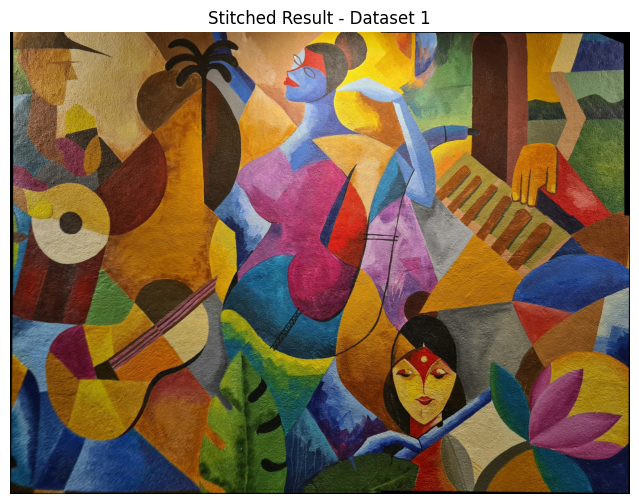


[INFO] Processing dataset 2
[INFO] Canvas origin offset: (0,-8), size: 2026x1352
[INFO] Saved stitched result: stitched_results\stitched_dataset_2.png


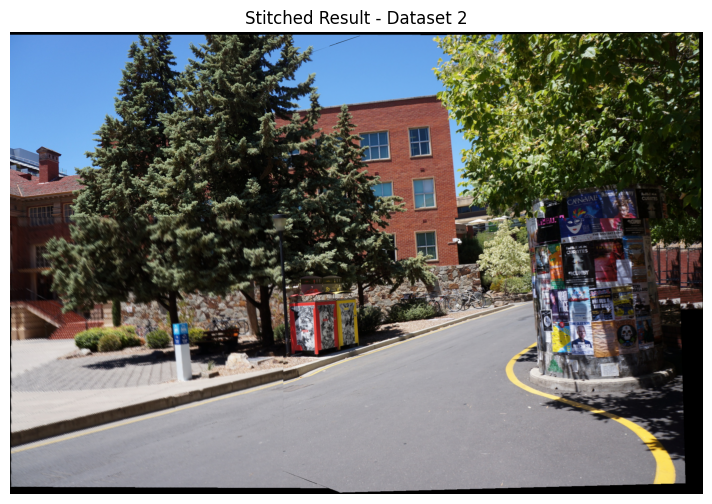


[INFO] Processing dataset 3
[INFO] Canvas origin offset: (-13,-3), size: 1314x798
[INFO] Saved stitched result: stitched_results\stitched_dataset_3.png


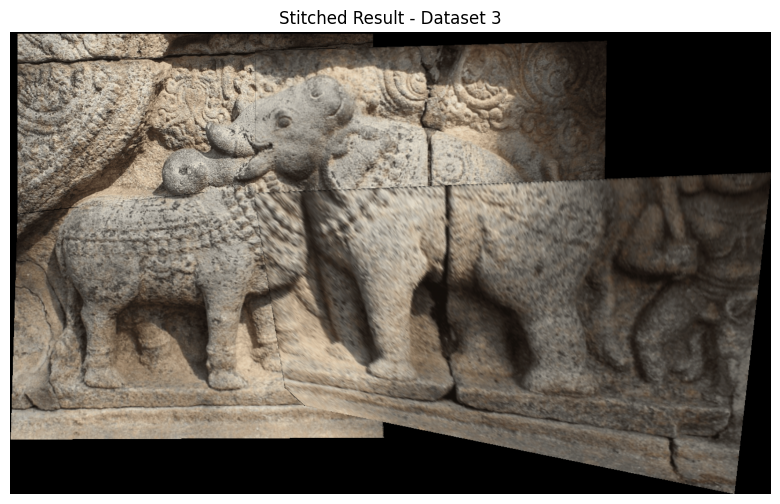


[INFO] Processing dataset 4
[INFO] Canvas origin offset: (-2,-5), size: 3345x2505
[INFO] Saved stitched result: stitched_results\stitched_dataset_4.png


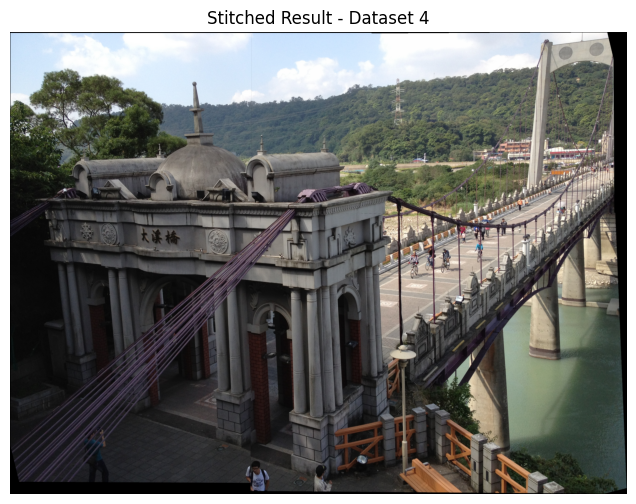


[INFO] Processing dataset 5
[INFO] Canvas origin offset: (-5,-1), size: 2146x1590
[INFO] Saved stitched result: stitched_results\stitched_dataset_5.png


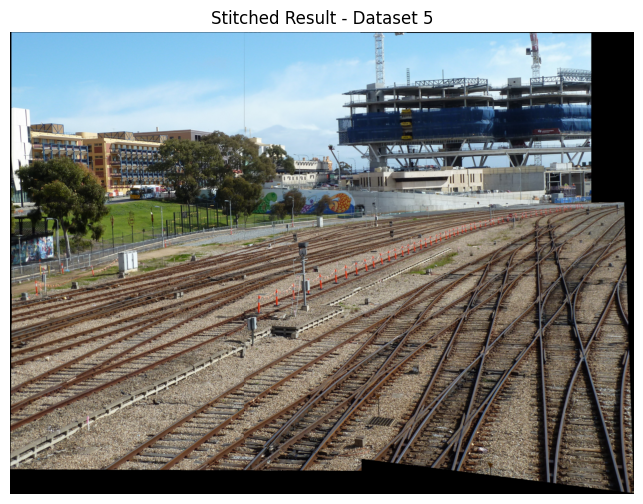

In [13]:
# ----------------------------
# Run stitching on all datasets
# ----------------------------
stitched_all = []
output_dir = "stitched_results"
os.makedirs(output_dir, exist_ok=True)

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\n[INFO] Processing dataset {dataset_idx+1}")

    # First image is reference (Region 1)
    ref_img = dataset_images[0]

    # Remaining images are other regions
    other_imgs = dataset_images[1:]

    # Homographies for this dataset
    homographies = homographies_all[dataset_idx]

    # Stitch
    stitched = stitch_with_known_homographies(ref_img, other_imgs, homographies)
    stitched_all.append(stitched)

    # Save
    save_path = os.path.join(output_dir, f"stitched_dataset_{dataset_idx+1}.png")
    cv2.imwrite(save_path, stitched)
    print(f"[INFO] Saved stitched result: {save_path}")

    # Show
    stitched_rgb = stitched
    plt.figure(figsize=(12,6))
    plt.imshow(stitched_rgb)
    plt.title(f"Stitched Result - Dataset {dataset_idx+1}")
    plt.axis("off")
    plt.show()

📖 **Theory Question:** Why is it important that the base image remains unaltered during stitching?

**Answer:**


The base image acts as the fixed reference coordinate frame (an anchor) for all other regions. If it is altered during stitching (e.g., overwritten or warped), all the computed homographies for other regions (which were calculated based on the original base image) become misaligned with it, causing distortions or gaps in the final stitched image. Keeping the base image unaltered ensures that all warped regions align consistently, preserving the scene's true geometry.